In [7]:
import essentia.standard as es
import numpy as np
import matplotlib.pyplot as plt
from essentia import Pool
from essentia import db2amp
from IPython.display import Audio

plt.rcParams["figure.figsize"] =(12,9)

In [2]:
def spectrogram(audio, frameSize=1024, hopSize=512, db=True):
    """
    Auxiliar fuction to plot spectrograms
    """
    eps = np.finfo(np.float32).eps
    window = es.Windowing(size=frameSize)
    spectrum = es.PowerSpectrum(size=frameSize)
    pool = Pool()
    for frame in es.FrameGenerator(audio, frameSize=frameSize,
                                   hopSize=hopSize, startFromZero=True):
        pool.add('spectrogram', spectrum(window(frame)))
        
    if db:
        return 10 * np.log10(pool['spectrogram'].T + eps)
    else:
        return pool['spectrogram'].T

# HumDetector

This algorithm detects low frequency tonal noises in the audio signal. First, the steadiness of the Power Spectral Density (PSD) of the signal is computed by measuring the quantile ratios as discribed in [1]. After this, the PitchContours algorithm is used to keep track of the humming tones[2][3].

References:
  [1] Brandt, M., & Bitzer, J. (2014). Automatic Detection of Hum in Audio Signals. Journal of the Audio Engineering Society, 62(9), 584-595.
  [2] J. Salamon and E. Gómez, Melody extraction from polyphonic music signals using pitch contour characteristics, IEEE Transactions on Audio, Speech, and Language Processing, vol. 20, no. 6, pp. 1759–1770, 2012.
  [3] The Essentia library,
    http://essentia.upf.edu/documentation/reference/streaming_PitchContours.html
    
 
# Humming frequencies
Sometimes audio files are contaminated with low-frequency humming tones degrading the audio quality. Typical causes for this problems are the electric installation frequency (typically 50 / 60Hz) or poor electrical isolation on the recording/copying equipment.
To simulate this phenomenon we will simply add a 50 Hz sinusoid with some harmonics.

Note that we are downsampling to 2kHz as we are only interested in the lowest part of the spectrum. In the following plots, we can the spectrogram of an example song up to 1kHz before and after adding the noise.

Text(0.5,1.05,u'Contaminted audio')

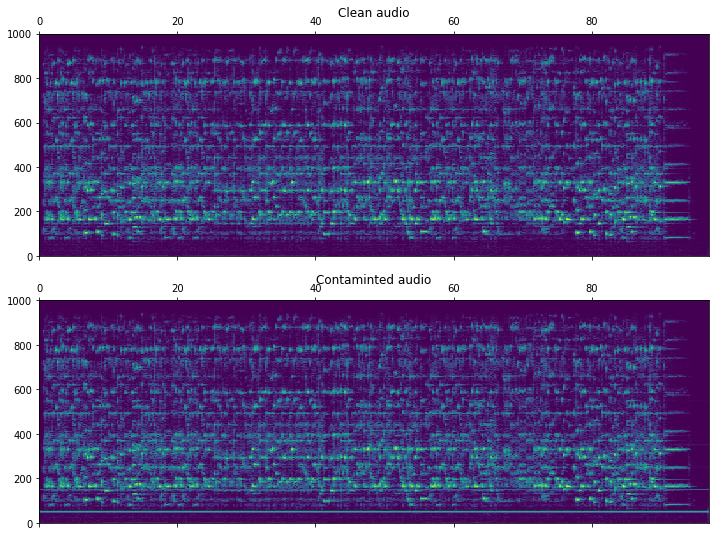

In [15]:
file_name = '/home/pablo/reps/essentia/test/audio/recorded/Vivaldi_Sonata_5_II_Allegro.wav'
audio = es.MonoLoader(filename=file_name)()

# downsampling
fs = 44100.
out_fs = 2000
audio_decimated = es.Resample(inputSampleRate=fs, outputSampleRate=out_fs)(audio)

# generating the humming tone
nSamples = len(audio)
time = np.linspace(0, nSamples / 44100., nSamples)

freq = 50. # Hz

hum = 1.5 * np.sin(2 * np.pi * freq * time )

# adding some harmonics via clipping
hum = es.Clipper(min=-1., max=1.)(hum.astype(np.float32))

# adding some attenuation
hum *= db2amp(-36.)

audio_with_hum = np.array(audio + hum, dtype=np.float32)

audio_with_hum_decimated = es.Resample(inputSampleRate=fs, outputSampleRate=out_fs)(audio_with_hum)

# ploting
fn = out_fs / 2.
f0 = 0.
f, ax = plt.subplots(2)
ax[0].matshow(spectrogram(audio_decimated), aspect='auto', origin='lower', extent=[0 , len(audio_decimated) / out_fs, f0, fn])
ax[0].set_title('Clean audio')
ax[1].matshow(spectrogram(audio_with_hum_decimated), aspect='auto', origin='lower', extent=[0 , len(audio_decimated) / out_fs, f0, fn])
ax[1].set_title('Contaminted audio')

## Original song 

In [16]:
Audio(audio, rate=fs)

## After adding the tone

In [17]:
Audio(audio_with_hum, rate=fs)

# The algorithm 

The detection algorithm relies on the fact that the humming tones are very constant on time. It measures the ratio between two quartiles of the power spectral density of the signal and expresses the results in a time vs. frequency matrix where the peaks can be tracked. The following example ilustrates the effect on choosing different quartile parameters.

Text(0.5,1.05,u'Q0=.1, Q1=.3')

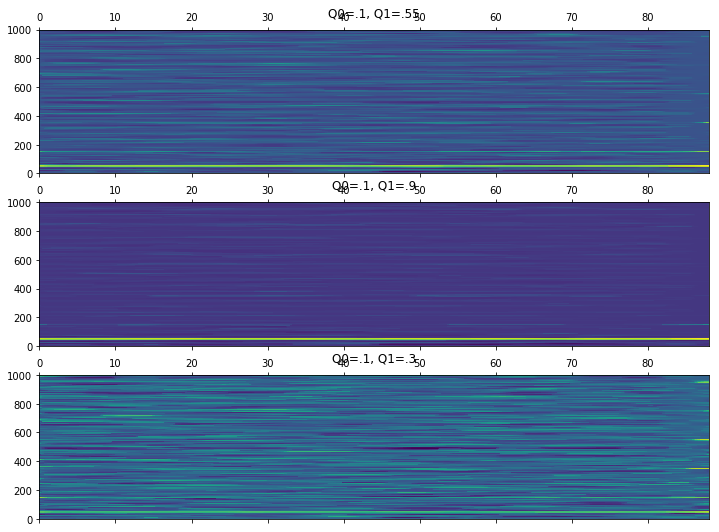

In [18]:
r0, _, _, _, _ = es.HumDetector(Q0=.1, Q1=.55)(audio_with_hum)

r1, _, _, _, _ = es.HumDetector(Q0=.1, Q1=.9)(audio_with_hum)

r2, _, _, _, _ = es.HumDetector(Q0=.1, Q1=.3)(audio_with_hum)

_, ax = plt.subplots(3)
f0 = 0
fn = 1000
ax[0].matshow(r0, aspect='auto', origin='lower', extent=[0 , r0.shape[1] * .2, f0, fn])
ax[0].set_title('Q0=.1, Q1=.55')

ax[1].matshow(r1, aspect='auto', origin='lower', extent=[0 , r1.shape[1] * .2, f0, fn])
ax[1].set_title('Q0=.1, Q1=.9')

ax[2].matshow(r2, aspect='auto', origin='lower', extent=[0 , r2.shape[1] * .2, f0, fn])
ax[2].set_title('Q0=.1, Q1=.3')

From the first plot, it can be seen how the 3 first harmonics can be clearly identified. Separating the quartiles as in the second example can help to clean the undesired frequencies but also degrades the detection of the second harmonic.  From the last example, it can be seen how if the quartiles are to close is not enough to get information about the stable regions

detected a 51.95Hz tone with salience 0.82 starting at 92.40s and ending at 98.00s
detected a 50.49Hz tone with salience 0.68 starting at 14.40s and ending at 92.60s


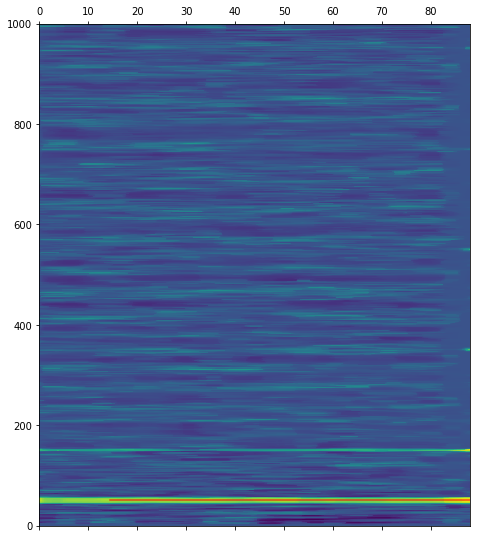

In [19]:
r0, freqs, saliences, starts, ends = es.HumDetector(Q0=.1, Q1=.55, detectionThreshold=5)(audio_with_hum)

plt.matshow(r0, aspect='auto', origin='lower', extent=[0 , r0.shape[1] * .2, f0, fn])
aLen = r0.shape[1] * .2
for i in range(len(freqs)):
    plt.axhline(y=freqs[i], xmin=starts[i] / aLen, xmax=ends[i] / aLen, alpha = saliences[i], color='r')
    
    print 'detected a {:.2f}Hz tone with salience {:.2f} starting at {:.2f}s and ending at {:.2f}s'\
          .format(freqs[i], saliences[i], starts[i], ends[i])